# Udacity Project 5 Vehicle Detection

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
import random
import cv2
import glob
import pickle
import time
import csv
import os.path
import pandas as pd

from scipy.ndimage.measurements import label
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.externals import joblib
from sklearn.svm import SVC
from skimage.feature import hog
from tqdm import tqdm
from skopt import gp_minimize
from skopt.plots import plot_convergence

%matplotlib inline

plot_demos = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9] # empty = no demo and no parameter search


# 0 Helper functions

In [2]:
def norm_0_255(img):
    """ Normalize img input to range from int 0 to 255
    """

    img_min = np.min(img)
    img_max = np.max(img)
    range_img = img_max - img_min
    result = (img-img_min)/range_img*255
    return(np.asarray(result, dtype='uint8'))
   
## Helper function to draw boxes on image
def draw_boxes(img, bboxes, color=(0, 255, 0), thick=5):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

def edge_enhancement(img, max_value=8):
    """OpenCV with Python By Example by Prateek Joshi
    """

    kernel = np.array([[-1,-1,-1,-1,-1],
                         [-1,2,2,2,-1],
                         [-1,2,max_value,2,-1],
                         [-1,2,2,2,-1],
                         [-1,-1,-1,-1,-1]]) / max_value

    output = cv2.filter2D(img,-1,kernel)
    
    return output

# plot images side by side
def plot_two_images(img, img2, size=(13,5), set_axis = 'off',show = 1,
                    titles = [' ',' '], save_it = 0, save_name ='img', cmap='inferno',colorbar = 0):
    """ Plots two images side by side 
    """
    f = plt.figure(figsize=size)
    ysize = img.shape[0]
    xsize = img.shape[1]
    
    ax1 = plt.subplot(121)
    plt.axis(set_axis)
    im = ax1.imshow(img, cmap=cmap)   
    plt.title(titles[0])
    ax1.set_ylim(ysize, 0)
    ax1.set_xlim(0, xsize)
    if colorbar:
        divider = make_axes_locatable(ax1)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        
    #############################
    ysize = img2.shape[0]
    xsize = img2.shape[1]
    
    ax2 = plt.subplot(122)
    plt.axis(set_axis)
    im = ax2.imshow(img2, cmap=cmap)
    plt.title(titles[1])
    plt.subplots_adjust(top=0.95,bottom=0.05,left=0.0,right=1.0,hspace=0.05,wspace=0.15)
    ax2.set_ylim(ysize, 0)
    ax2.set_xlim(0, xsize)
    if colorbar:
        divider = make_axes_locatable(ax2)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        
    if save_it:
        plt.savefig('./output_images/' + save_name + '.png')
    if show:
        plt.show()
        
    return f, ax1, ax2

# get paths of cars and not cars images
def load_dataset(howmany=None):
    images = glob.glob('./datasets/vehicles/*/*.png')
    cars = []
    for image in images:
        cars.append(image)

    notcars = []
    images = glob.glob('./datasets/non-vehicles/*/*.png')
    
    for image in images:
        notcars.append(image)

    if howmany != None:
        cars = cars[0:howmany]
        notcars = notcars[0:howmany]
        
    return cars, notcars

def conv_img(image, color_space):
    # apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        elif color_space == 'LAB':
            image = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    else:
        print('image is kept in RGB')
            
    return image

def eq_hist_img(img):
    
    img_yuv = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)

    # equalize the histogram of the Y channel
    img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])

    # convert the YUV image back to RGB format
    img_output = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)

    return img

def preprocess_img(img, color_space = 'RGB', edge_enhance = 0):
    
    if np.amax(img) <= 1:
        img  = np.asarray(img * 255, dtype='uint8')
    else:
        img  = np.asarray(img, dtype='uint8')
    
    if edge_enhance:
        img = edge_enhancement(img)
        
    img = eq_hist_img(img) 
    
    if color_space != 'RGB':
        img = conv_img(img, color_space)
    
    img = np.asarray(img / 255, dtype='float32')
    
    return img

# load images from given path and normalizing to scale 0 to 1
def load_image(path):
    
    img = mpimg.imread(path)
    
    return img
      
# simply plot the feature vector 
def visualize_features(features, save_it = 0, save_name ='img'):
    plt.figure(figsize=(13,5))
    print('len(features.shape)', len(features.shape))
    if len(features.shape) > 1:
        for i in range(features.shape[0]):
            plt.plot(features[i])
            plt.title('HOG from first(green), second (blue) and third (orange) channels')
    else:
            plt.plot(features)
            plt.title(features.shape)
    
    if save_it:
        plt.savefig('./output_images/' + save_name + '.png')
        
    plt.show()
    
    return

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)


# 1 Dataset Summary & Exploration

Number of training examples = 8792  car images, 8968  not car images


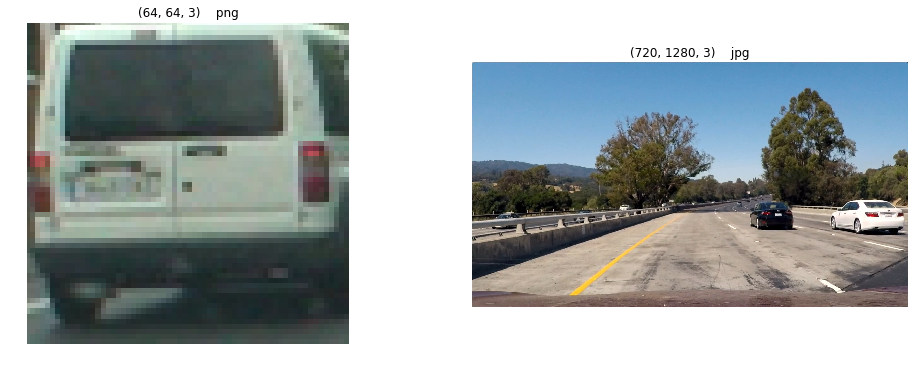

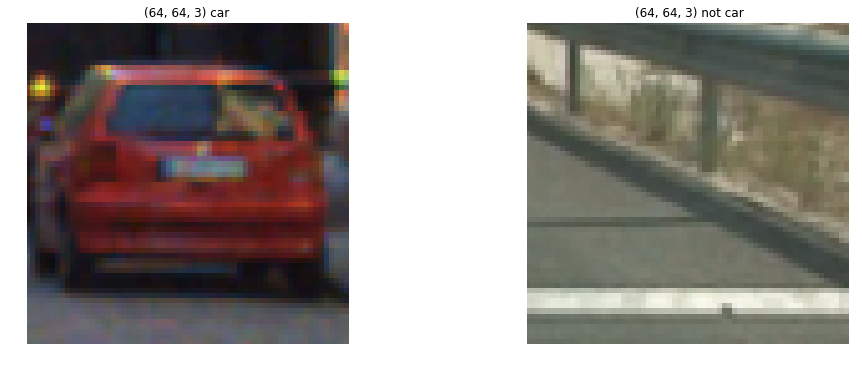

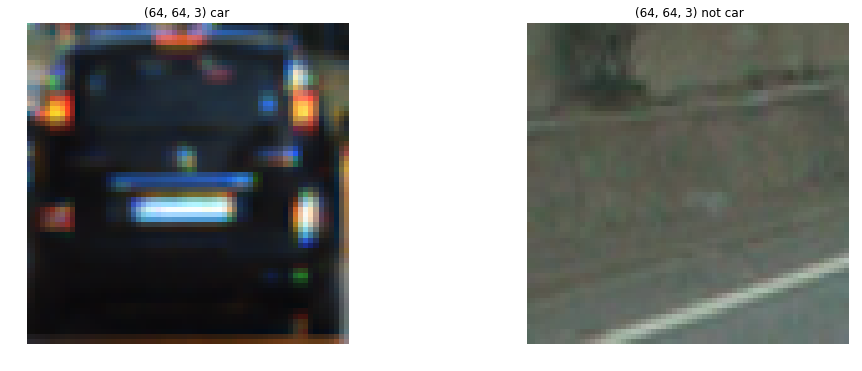

In [3]:
cars, notcars = load_dataset()

# Number of training examples
n_cars = len(cars) 
n_notcars =  len(notcars)

print("Number of training examples =", n_cars , ' car images,',  n_notcars,' not car images')

ran_index = random.randint(0, len(cars)) 

if 1 in plot_demos :
    img_png = load_image(cars[ran_index])
    img_png = preprocess_img(img_png)
    img_jpg = load_image('./test_images/test1.jpg')
    img_jpg = preprocess_img(img_jpg)

    # What's the shape of an image?
    png_shape = img_png.shape
    jpg_shape = img_jpg.shape

    plot_two_images(img_png, img_jpg, titles = [str(png_shape) + '    png',
                                                 str(jpg_shape) + '    jpg'], save_it = 1, save_name ='example_images') 

    for i in range(2):
        ran_index = random.randint(0, min(len(cars),len(notcars))) 
        car_img = load_image(cars[ran_index])  
        car_img = preprocess_img(car_img)

        ncar_img = load_image(notcars[ran_index]) 
        ncar_img = preprocess_img(ncar_img)
        # What's the shape of an image?
        image_shape = car_img.shape
        image_shape2 = ncar_img.shape

        plot_two_images(car_img, ncar_img, titles = [str(image_shape) + ' car ',
                                                 str(image_shape2) + ' not car'], save_it = 1, save_name ='example_images2') 


# 2 Feature Extraction

### 2.1 HOG

In [4]:
def get_hog_features(img, orient, pix_per_cell, cell_per_block, 
                        vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, orientations=orient, 
                                  pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), 
                                  transform_sqrt=True, block_norm='L2-Hys', 
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(img, orientations=orient, 
                       pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), 
                       transform_sqrt=True, block_norm='L2-Hys',
                       visualise=vis, feature_vector=feature_vec)
        return features


#### 2.1.2 HOG Example on colorchannel images

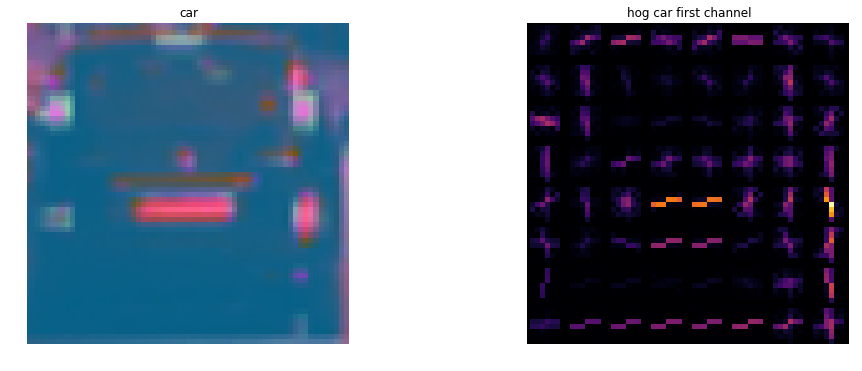

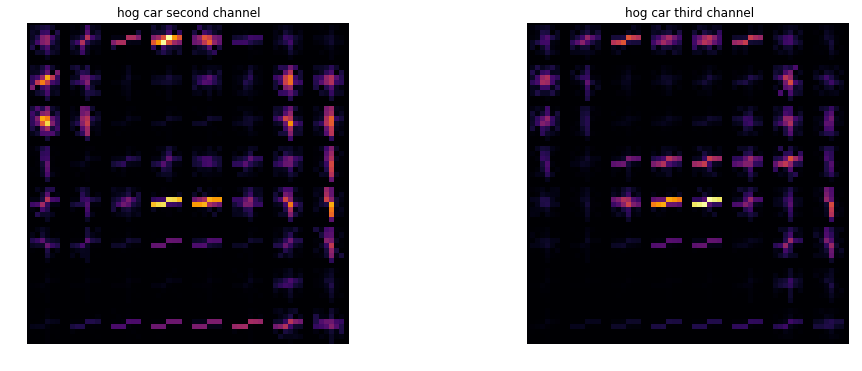

len(features.shape) 2


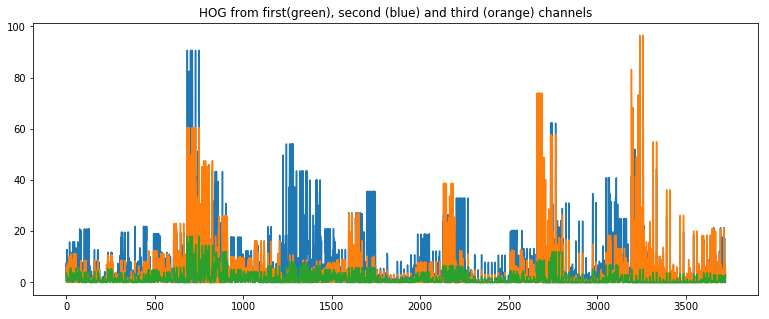

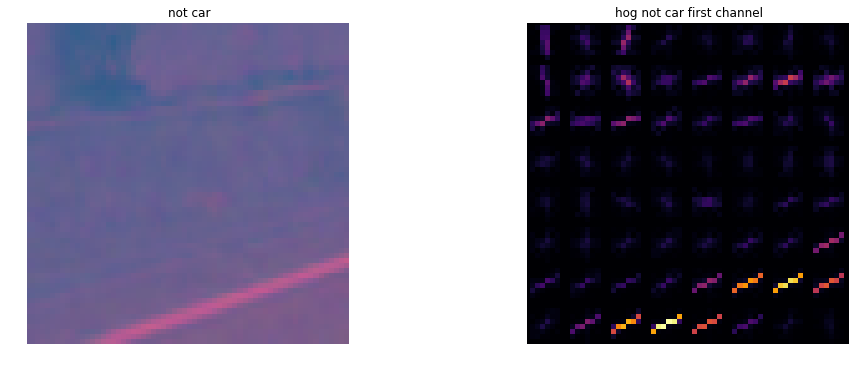

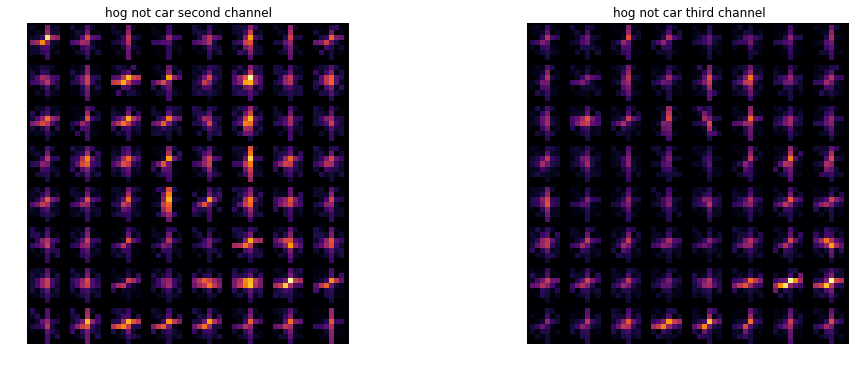

len(features.shape) 2


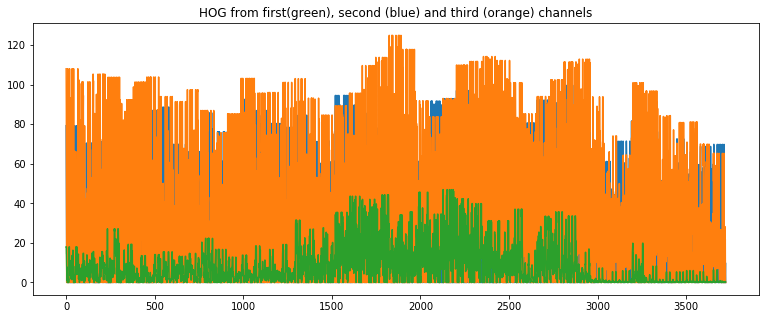

In [5]:
orient = 19
pix_per_cell = 8
cell_per_block = 2

# ran_index = random.randint(0, min(len(cars),len(notcars))) 
if 2 in plot_demos:
    ############################
    car_img = load_image(cars[ran_index])  
    car_img = preprocess_img(car_img, color_space = 'LUV')
    hog_fea_car0, hog_car0 = get_hog_features(car_img[:,:,0], orient, pix_per_cell, cell_per_block, vis=True, feature_vec=True)

    hog_fea_car1, hog_car1 = get_hog_features(car_img[:,:,1], orient, pix_per_cell, cell_per_block, vis=True, feature_vec=True)

    hog_fea_car2, hog_car2 = get_hog_features(car_img[:,:,2], orient, pix_per_cell, cell_per_block, vis=True, feature_vec=True)

    plot_two_images(car_img, hog_car0, titles = ['car', 'hog car first channel'], save_it = 1, save_name ='hog_car1') 
    plot_two_images(hog_car1, hog_car2, titles = ['hog car second channel', 'hog car third channel'], save_it = 1, save_name ='hog_car2') 
    visualize_features(np.vstack((hog_fea_car1, hog_fea_car2, hog_fea_car0)), save_it = 1, save_name ='hog_feat_car')

    #############################
    ncar_img = load_image(notcars[ran_index]) 
    ncar_img = preprocess_img(ncar_img, color_space = 'LUV')

    hog_fea_ncar0, hog_ncar0 = get_hog_features(ncar_img[:,:,0], orient, pix_per_cell, cell_per_block, vis=True, feature_vec=True)

    hog_fea_ncar1, hog_ncar1 = get_hog_features(ncar_img[:,:,1], orient, pix_per_cell, cell_per_block, vis=True, feature_vec=True)

    hog_fea_ncar2, hog_ncar2 = get_hog_features(ncar_img[:,:,2], orient, pix_per_cell, cell_per_block, vis=True, feature_vec=True)

    plot_two_images(ncar_img, hog_ncar0, titles = ['not car', 'hog not car first channel'], save_it = 1, save_name ='hog_notcar1') 
    plot_two_images(hog_ncar1, hog_ncar2, titles = ['hog not car second channel', 'hog not car third channel'], save_it = 1, save_name ='hog_notcar2') 
    visualize_features(np.vstack((hog_fea_ncar1, hog_fea_ncar2, hog_fea_ncar0)), save_it = 1, save_name ='hog_feat_notcar')

    

### 2.2 Spatial binned color features

In [6]:
# Define a function to compute binned color features  
def bin_spatial(img, size=16):
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, (size,size)).ravel() 
    # Return the feature vector
    return features


#### 2.2.1 Example Spatial binned color features

Shape of spatial binned color feature vector of      car      image:  (768,)
len(features.shape) 1


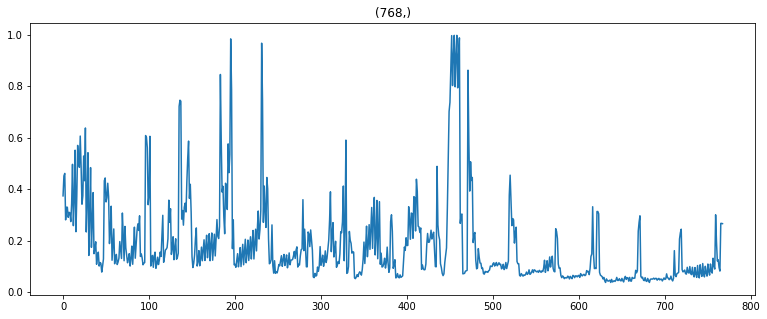

Shape of spatial binned color feature vector of      not-car      image:  (768,)
len(features.shape) 1


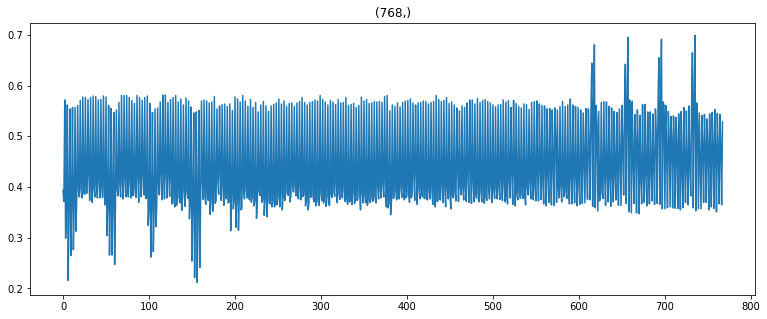

In [7]:
spatial_size = 16  # Spatial binning dimensions

if 3 in plot_demos:
    car_img = load_image(cars[ran_index])
    ncar_img = preprocess_img(car_img, color_space = 'LUV')

    features = bin_spatial(car_img, size=spatial_size)
    print('Shape of spatial binned color feature vector of      car      image: ',features.shape)
    visualize_features(features, save_it = 1, save_name ='spatial_car')### New heading

    ncar_img = load_image(notcars[ran_index])
    ncar_img = preprocess_img(ncar_img, color_space = 'LUV')

    features = bin_spatial(ncar_img, size=spatial_size)
    print('Shape of spatial binned color feature vector of      not-car      image: ',features.shape)
    visualize_features(features, save_it = 1, save_name ='spatial_notcar')### New heading

### 2.3 Color histogram features

In [8]:
# Define a function to compute color histogram features 
def color_hist(img, nbins=32):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features

#### 2.3.1 Example Color histogram features

Shape of spatial Color histogram feature vector of      car      image:  (96,)
len(features.shape) 1


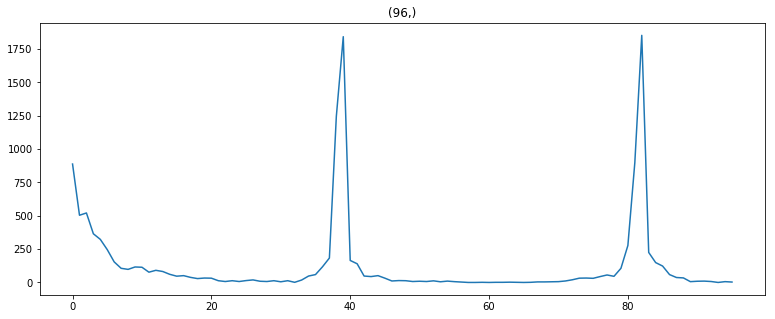

Shape of spatial Color histogram feature vector of      not-car      image:  (96,)
len(features.shape) 1


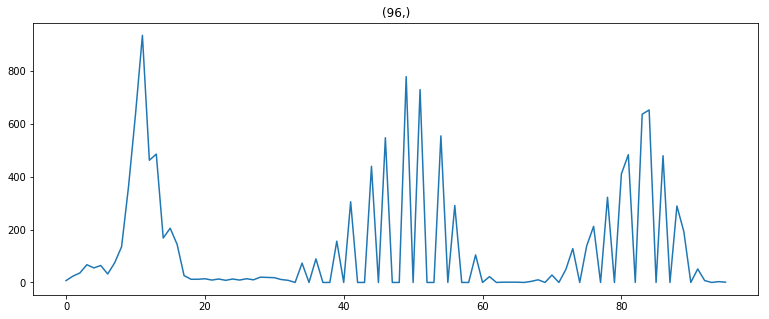

In [9]:
hist_bins = 32 # Number of histogram bins

if 4 in plot_demos:

    car_img = load_image(cars[ran_index])
    car_img = preprocess_img(car_img, color_space = 'LUV')

    features = color_hist(car_img, nbins=hist_bins)
    print('Shape of spatial Color histogram feature vector of      car      image: ',features.shape)
    visualize_features(features, save_it = 1, save_name ='colorbins_car')

    ncar_img = load_image(notcars[ran_index])
    ncar_img = preprocess_img(ncar_img, color_space = 'LUV')

    features = color_hist(ncar_img, nbins=hist_bins)
    print('Shape of spatial Color histogram feature vector of      not-car      image: ',features.shape)
    visualize_features(features, save_it = 1, save_name ='colorbins_notcar')



### 2.4 Complete Feature Extraction pipeline

In [10]:
# Define a function to extract features from an image
def extract_features(img_path, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel='ALL',
                        spatial_feat=True, hist_feat=True, hog_feat=True, path =True):
    # Create a list to append feature vectors to
    file_features = []
    
    # load image
    if path:
        image = load_image(img_path)
        image = preprocess_img(image, color_space = color_space)
    else:
        image = img_path
        
    feature_image = np.copy(image)   
    
    # hog features
    hog_features = []
    if hog_feat == True:
        if hog_channel == 'ALL':
            
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)        
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        file_features.append(hog_features)
        
    # spatial features
    spatial_features = []
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        file_features.append(spatial_features)
        
    # histogram features  
    hist_features = []
    if hist_feat == True:
        hist_features = color_hist(feature_image, nbins=hist_bins)
        file_features.append(hist_features)
        
    if path:
        return np.concatenate(file_features) 
    else: 
        return hog_features, spatial_features, hist_features

#### 2.4.1 Example Complete Feature Extraction pipeline

Shape of combined feature vector for car image:  (1836,)
len(features.shape) 1


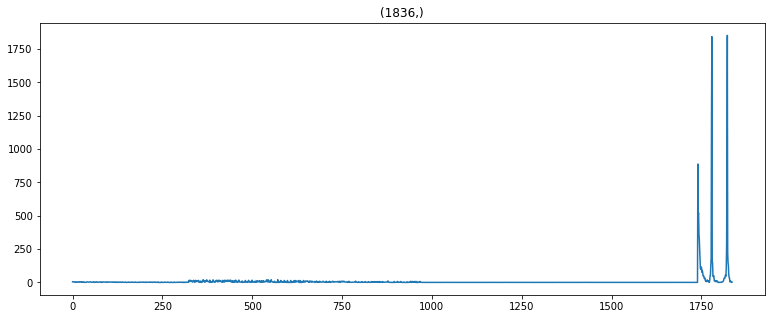

Shape of combined feature vector for not-car image:  (1836,)
len(features.shape) 1


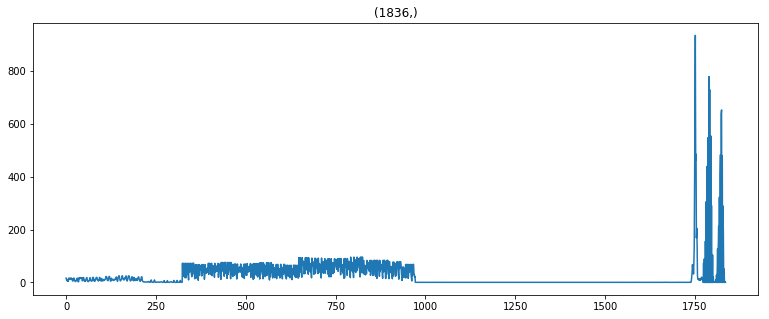

In [11]:
if 5 in plot_demos:
    color_space = 'LUV'  # Can be RGB, HSV, LUV, HLS, YUV, YCrCb

    hog_feat = True  # HOG features on or off
    orient = 9  # HOG orientations
    pix_per_cell = 16  # HOG pixel per cell
    cell_per_block = 2  # HOG cells per block
    hog_channel = "ALL"  # Can be 0, 1, 2, or "ALL"

    spatial_feat = True  # Spatial features on or off
    spatial_size = 16  # Spatial binning dimensions

    hist_feat = True  # Histogram features on or off
    hist_bins = 32 # Number of histogram bins


    # print(cars[ran_index])
    features = extract_features(cars[ran_index], color_space=color_space, spatial_size=spatial_size, hist_bins=hist_bins,
                                    orient=orient, pix_per_cell=pix_per_cell, cell_per_block=cell_per_block,
                                    hog_channel=hog_channel, spatial_feat=spatial_feat,
                                    hist_feat=hist_feat, hog_feat=hog_feat)
    print('Shape of combined feature vector for car image: ',features.shape)
    visualize_features(features, save_it = 1, save_name ='feats_car')


    features = extract_features(notcars[ran_index], color_space=color_space, spatial_size=spatial_size, hist_bins=hist_bins,
                                    orient=orient, pix_per_cell=pix_per_cell, cell_per_block=cell_per_block,
                                    hog_channel=hog_channel, spatial_feat=spatial_feat,
                                    hist_feat=hist_feat, hog_feat=hog_feat)
    print('Shape of combined feature vector for not-car image: ',features.shape)
    visualize_features(features, save_it = 1, save_name ='feats_notcar')


### 2.5 Pipeline on dataset

In [12]:
def pipeline_dataset(files, color_space='RGB', spatial_size=16,
                     hist_bins=32, orient=9,
                     pix_per_cell=8, cell_per_block=2, hog_channel='ALL',
                     spatial_feat=True, hist_feat=True, hog_feat=True):
    
    # Create a list to append feature vectors to
    features = []
    
    # Iterate through the list of images
    for file in tqdm(files):
        file_features = extract_features(file, color_space=color_space, spatial_size=spatial_size, hist_bins=hist_bins,
                                orient=orient, pix_per_cell=pix_per_cell, cell_per_block=cell_per_block,
                                hog_channel=hog_channel, spatial_feat=spatial_feat,
                                hist_feat=hist_feat, hog_feat=hog_feat)
    
        features.append(file_features)
            
    # Return list of feature vectors
    return np.array(features)


# Demo
if 6 in plot_demos: 
    color_space = 'LUV'  # Can be RGB, HSV, LUV, HLS, YUV, YCrCb

    hog_feat = True  # HOG features on or off
    orient = 9  # HOG orientations
    pix_per_cell = 16  # HOG pixel per cell
    cell_per_block = 2  # HOG cells per block
    hog_channel = "ALL"  # Can be 0, 1, 2, or "ALL"

    spatial_feat = True  # Spatial features on or off
    spatial_size = 16 # Spatial binning dimensions

    hist_feat = True  # Histogram features on or off
    hist_bins = 32  # Number of histogram bins

    car_features = pipeline_dataset(cars[0:len(cars):20], color_space=color_space,
                                    spatial_size=spatial_size, hist_bins=hist_bins,
                                    orient=orient, pix_per_cell=pix_per_cell,
                                    cell_per_block=cell_per_block,
                                    hog_channel=hog_channel, spatial_feat=spatial_feat,
                                    hist_feat=hist_feat, hog_feat=hog_feat)
    print('shape of car features: ', car_features.shape)

    notcar_features = pipeline_dataset(notcars[0:len(cars):20], color_space=color_space,
                                       spatial_size=spatial_size, hist_bins=hist_bins,
                                       orient=orient, pix_per_cell=pix_per_cell,
                                       cell_per_block=cell_per_block,
                                       hog_channel=hog_channel, spatial_feat=spatial_feat,
                                       hist_feat=hist_feat, hog_feat=hog_feat)
    print('shape of not car features: ', notcar_features.shape)



100%|███████████████████████████████████████████████████████████████████████████████| 440/440 [00:03<00:00, 129.34it/s]


shape of car features:  (440, 1836)


100%|███████████████████████████████████████████████████████████████████████████████| 440/440 [00:03<00:00, 131.70it/s]


shape of not car features:  (440, 1836)


### 2.6 Normalize features 

In [13]:
def scale_features(car_features, notcar_features, verbose = 1):
    
    X = np.vstack((car_features, notcar_features)).astype(np.float64)
    
    # Fit a per-column scaler
    X_scaler = StandardScaler().fit(X)
    # Apply the scaler to X
    scaled_X = X_scaler.transform(X)

    # Define the labels vector
    y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

    # Split up data into randomized training and test sets
    rand_state = np.random.randint(0, 99)
    X_train, X_test, y_train, y_test = train_test_split(scaled_X, y, test_size=0.2, random_state=rand_state)
    if verbose:
        print('Shape of entire feature set:', X.shape)
        print('Shape of train set:', X_train.shape)
        print('Shape of train set:', X_test.shape)
        print('Feature vector length:', len(X_train[0]))
    
    return X_scaler, X_train, X_test, y_train, y_test


#### 2.6.1 Example: Scale features to training data 

Shape of entire feature set: (880, 1836)
Shape of train set: (704, 1836)
Shape of train set: (176, 1836)
Feature vector length: 1836


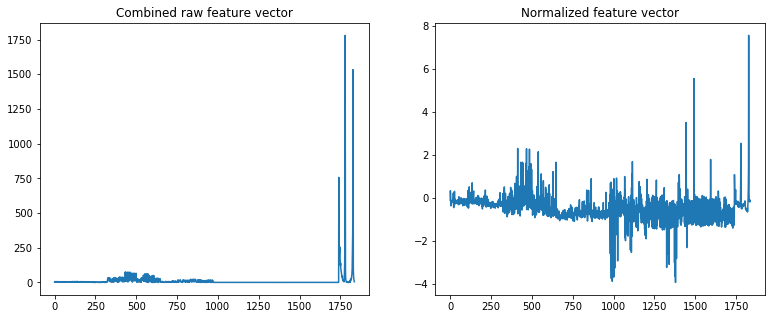

In [14]:
if 6 in plot_demos: 
    X_scaler, X_train, X_test, y_train, y_test = scale_features(car_features, notcar_features)
    
    ran_index = random.randint(0, len(car_features)) 
    
    example_features = car_features[ran_index]
    normalized_example = np.vstack((example_features, example_features)).astype(np.float64)
    normalized_example = X_scaler.transform(normalized_example)
        
    plt.figure(figsize=(13,5))
    plt.subplot(121)
    plt.title('Combined raw feature vector')
    plt.plot(example_features)
    plt.subplot(122)
    plt.title('Normalized feature vector')
    plt.plot(normalized_example[0])
    
    plt.savefig('./output_images/scaled_feats.png')
    plt.show()

### 2.7 Linear dimensionality reduction with PCA

In [15]:
def apply_PCA(X_train, X_test, y_train, y_test, reduc_factor=4, verbose = 1):
    
    n_components = round(len(X_train[0])//reduc_factor)
    
    pca = PCA( n_components=n_components, svd_solver='randomized',whiten=True).fit(X_train)

    #Projecting the input data on the eigenfaces orthonormal basis
    X_train_pca = pca.transform(X_train)
    X_test_pca = pca.transform(X_test)
    
    if verbose:
        print('Shape X_train_pca:', X_train_pca.shape)
    
    return pca, X_train_pca, X_test_pca

#### 2.7.1 Example Linear dimensionality reduction with PCA

Shape X_train: (704, 1836)
Shape X_train_pca: (704, 183)


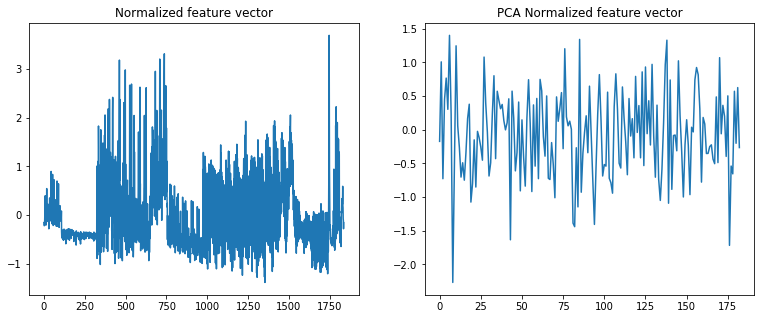

done


In [16]:
if 8 in plot_demos: 
    # Example
    if 'X_train' not in globals():
        feature_files = glob.glob('./datasets/pfiles/features_*.p')

        with open(feature_files[0], mode='rb') as handle:
                features_pfile = pickle.load(handle)
        print('loaded: ', feature_files[0])

        X_scaler = features_pfile['X_scaler']
        X_train = features_pfile['X_train']
        X_test = features_pfile['X_test']
        y_train = features_pfile['y_train']
        y_test = features_pfile['y_test']
        
    print('Shape X_train:', X_train.shape)
    pca, X_train_pca, X_test_pca = apply_PCA(X_train, X_test, y_train, y_test, reduc_factor=10)
    
    example_features = X_train[ran_index]
    pca_example = X_train_pca[ran_index]
    
#     normalized_example = X_scaler.transform(normalized_example)

    plt.figure(figsize=(13,5))
    plt.subplot(121)
    plt.title('Normalized feature vector')
    plt.plot(example_features)
    plt.subplot(122)
    plt.title('PCA Normalized feature vector')
    plt.plot(pca_example)
    plt.savefig('./output_images/PCA_reduced.png')
    plt.show()
    
    print('done')

# 3 Training

### 3.1 Definition of SVM-classifier

In [17]:
def train_SVM(X_train, X_test, y_train, y_test, kernel='linear', C=5.0, gamma = 0.001, verbose=1):

    # Instantiate a SVM classifier
    svc = SVC(kernel=kernel, C=C, gamma=gamma)
    
    # Check the training time for the SVM
    t1 = time.time()
    
    svc.fit(X_train, y_train)
    
    t2 = time.time()
    time_fit = round(t2 - t1, 5)
    
    
        
    # Log accuracy on test set
    accuracy = round(svc.score(X_test, y_test), 5)
    
    
    # Log prediction time as another performance indicator
    len_test = len(X_test)
    
    t1 = time.time()
    prediction = svc.predict(X_test)
    t2 = time.time()
    
    time_prediction = round((t2 - t1)/len_test*100, 6)
    if verbose:
        print(time_fit, 'seconds to train SVC')
        print(accuracy, ' Accuracy')
        print(time_prediction, 'seconds to predict 100 samples')
    
    return svc, accuracy, time_fit, time_prediction

#### 3.1.1 Example of complete Pipeline with SVM training

In [18]:
if 9 in plot_demos: 
    ## Demo
    color_space = 'LUV'  # Can be RGB, HSV, LUV, HLS, YUV, YCrCb

    orient = 9  # HOG orientations
    pix_per_cell = 16  # HOG pixel per cell
    cell_per_block = 2  # HOG cells per block
    hog_channel = "ALL"  # Can be 0, 1, 2, or "ALL"

    spatial_size = 16 # Spatial binning dimensions

    hist_bins = 16  # Number of histogram bins
    
    #######
    reduc_factor = 8
    
    kernel = 'linear'
    C = 1.
    gamma = 0.005
    
    print('color_space:', color_space,
      '  hog_orient:', orient,
      '  hog_pix_per_cell:', pix_per_cell,
      '  spatial_size:', spatial_size,
      '  color_hist_bins:', hist_bins,
      '  reduc_factor:',reduc_factor,
      '  C:', C,
      '  gamma:', gamma,
      '  kernel:', kernel)
    
    feature_filename = './datasets/pfiles/features_{}--{}_{}--{}--{}.p'.format(color_space, orient, pix_per_cell, spatial_size, hist_bins)
        
    if os.path.isfile(feature_filename):
        print(feature_filename, " p-file loaded")
        with open(feature_filename, mode='rb') as handle:
                features_pfile = pickle.load(handle)

        X_scaler = features_pfile['X_scaler']
        X_train = features_pfile['X_train']
        X_test = features_pfile['X_test']
        y_train = features_pfile['y_train']
        y_test = features_pfile['y_test']
        
    else:
        car_features = pipeline_dataset(cars, color_space=color_space,
                                        spatial_size=spatial_size, hist_bins=hist_bins,
                                        orient=orient, pix_per_cell=pix_per_cell,
                                        cell_per_block=cell_per_block, hog_channel=hog_channel)

        notcar_features = pipeline_dataset(notcars, color_space=color_space,
                                           spatial_size=spatial_size, hist_bins=hist_bins,
                                           orient=orient, pix_per_cell=pix_per_cell,
                                           cell_per_block=cell_per_block, hog_channel=hog_channel)
        
        X_scaler, X_train, X_test, y_train, y_test = scale_features(car_features, notcar_features)

        features_pfile = {'X_scaler' : X_scaler, 'X_train': X_train, 'X_test' : X_test, 'y_train': y_train, 'y_test': y_test}

        with open(feature_filename, 'wb') as handle:
                pickle.dump(features_pfile, handle, protocol=pickle.HIGHEST_PROTOCOL)
        print("p-file saved")        
    
    print('applying pca...')
    pca, X_train_pca, X_test_pca = apply_PCA(X_train, X_test, y_train, y_test, reduc_factor = reduc_factor )
    print('training...')
    svc, accuracy, train_time, time_prediction = train_SVM(X_train_pca, X_test_pca, y_train, y_test, kernel=kernel, C=C, gamma=gamma)


color_space: LUV   hog_orient: 9   hog_pix_per_cell: 16   spatial_size: 16   color_hist_bins: 16   reduc_factor: 8   C: 1.0   gamma: 0.005   kernel: linear
features_LUV--9_16--16--16.p  p-file loaded
applying pca...
Shape X_train_pca: (14208, 223)
training...
15.72202 seconds to train SVC
0.98508  Accuracy
0.011995 seconds to predict 100 samples


### 3.2 Parameter search

In [19]:
# Parameter via a csv-file and defined grid-search-steps, see Create_search_space.ipynb

if 10 in plot_demos: 
    search_space_file_name = 'search_space3.csv' 

    search_space = pd.read_table(search_space_file_name, sep=',')

    print('search space loaded')

    for index, para_row in search_space.iterrows():

        # Skip rows that are already calculated
        if para_row['accuracy'] != 0:
            continue

        # set this manually
        cell_per_block = 2
        hog_channel = "ALL"

        # get from csv
        color_space = para_row['color_space']
        orient = para_row['hog_orient']
        pix_per_cell = para_row['hog_pix_per_cell']
        spatial_size = para_row['spatial_size']
        hist_bins = para_row['color_hist_bins']

        reduc_factor = para_row['reduc_factor'] 

        C = para_row['C']
        gamma = para_row['gamma']
        kernel = para_row['kernel']

        #########
        print('color_space:', color_space,
              ' | hog_orient:', orient,
              ' | hog_pix_per_cell:', pix_per_cell,
              ' | spatial_size:', spatial_size,
              ' | ncolor_hist_bins:', hist_bins,
              ' | reduc_factor:',reduc_factor,
              ' | C:', C,
              ' | gamma:', gamma,
              ' | kernel:', kernel)

        # set feature filename
        feature_filename = './datasets/pfiles/features_{}--{}_{}--{}--{}.p'.format(color_space, orient, pix_per_cell, spatial_size, hist_bins)

        if os.path.isfile(feature_filename):
            print(feature_filename, " p-file loaded")
            with open(feature_filename, mode='rb') as handle:
                    features_pfile = pickle.load(handle)

            X_scaler = features_pfile['X_scaler']
            X_train = features_pfile['X_train']
            X_test = features_pfile['X_test']
            y_train = features_pfile['y_train']
            y_test = features_pfile['y_test']

        else:
            car_features = pipeline_dataset(cars, color_space=color_space,
                                            spatial_size=spatial_size, hist_bins=hist_bins,
                                            orient=orient, pix_per_cell=pix_per_cell,
                                            cell_per_block=cell_per_block, hog_channel=hog_channel)

            notcar_features = pipeline_dataset(notcars, color_space=color_space,
                                               spatial_size=spatial_size, hist_bins=hist_bins,
                                               orient=orient, pix_per_cell=pix_per_cell,
                                               cell_per_block=cell_per_block, hog_channel=hog_channel)

            X_scaler, X_train, X_test, y_train, y_test = scale_features(car_features, notcar_features)

            features_pfile = {'X_scaler' : X_scaler, 'X_train': X_train, 'X_test' : X_test, 'y_train': y_train, 'y_test': y_test}

            with open(feature_filename, 'wb') as handle:
                    pickle.dump(features_pfile, handle, protocol=pickle.HIGHEST_PROTOCOL)
            print("p-file saved")        

        print('applying pca...')
        pca, X_train_pca, X_test_pca = apply_PCA(X_train, X_test, y_train, y_test, reduc_factor = reduc_factor )
        print('training...')
        svc, accuracy, train_time, time_prediction = train_SVM(X_train_pca, X_test_pca, y_train, y_test, kernel=kernel, C=C, gamma=gamma)

        ############################# save to pandas 

        search_space.loc[index, 'features vector length'] = int(len(X_train_pca[0]))
        search_space.loc[index, 'training time'] = train_time
        search_space.loc[index, 'accuracy'] = accuracy   
        search_space.loc[index, 'time to predict 100'] = time_prediction

        # save pandas file back to hard drive
        search_space.to_csv(search_space_file_name, sep=',', index=False)
        print('search_space csv updated', end='\n')
        print('')


In [20]:
# Parameter via a minimizer gp_minimize from skopt

if 11 in plot_demos: 
    # RuntimeError: Can only compute distance for values within the space, not 0.01 and 0.00721937215405.
    search_space = [(10, 19),            # hog orient
                    (14, 18),            # hog pix_per_cell
                    (12, 18),            # spatial_size
                    (12, 18),            # color_hist_bins
                    (10, 25),            # reduc_factor
                    (5, 10),            # C
                    (20, 80)]      # gamma *10000 because of RuntimeError

    i = 0
    def obj(params):
        global i
        hog_channel = "ALL"
        color_space = 'LUV'
        kernel = 'rbf'
        cell_per_block = 2

        orient, pix_per_cell, spatial_size, hist_bins, reduc_factor, C , gamma = params
        print('collecting features...')
        # Because of: RuntimeError: Can only compute distance for values within the space, not 0.01 and 0.00721937215405.
        gamma = gamma/10000

        t1 = time.time()
        car_features = pipeline_dataset(cars[0:len(cars):5], color_space=color_space,
                                        spatial_size=spatial_size, hist_bins=hist_bins,
                                        orient=orient, pix_per_cell=pix_per_cell,
                                        cell_per_block=cell_per_block, hog_channel=hog_channel)

        notcar_features = pipeline_dataset(notcars[0:len(notcars):5], color_space=color_space,
                                           spatial_size=spatial_size, hist_bins=hist_bins,
                                           orient=orient, pix_per_cell=pix_per_cell,
                                           cell_per_block=cell_per_block, hog_channel=hog_channel)

        X_scaler, X_train, X_test, y_train, y_test = scale_features(car_features, notcar_features,verbose=0)

        _, X_train, X_test = apply_PCA(X_train, X_test, y_train, y_test, reduc_factor = reduc_factor,verbose=0 )

        time_getting_feat = time.time() - t1

        print('training...')
        _, accuracy, train_time, time_prediction = train_SVM(X_train, X_test, y_train, y_test, kernel=kernel, C=C, gamma=gamma, verbose=0)


        cost =  25*(1 - accuracy) + time_getting_feat/100 + time_prediction #+ cost_extra

        print(i,'  |  ', params,'  |  ', accuracy, '  |  feature time:',  time_getting_feat ,'  |  prediction time:', time_prediction, '  |  cost:', cost)

        i+=1

        return cost

    res = gp_minimize(obj, search_space, random_state=11, n_random_starts=8, n_calls=20)

    "Best score=%.4f" % res.fun
    orient, pix_per_cell, spatial_size, hist_bins, reduc_factor, C , gamma = res.x[0], res.x[1], res.x[2], res.x[3], res.x[4], res.x[5], res.x[6]/10000

    print("""Best parameters:
    - orient = %d
    - pix_per_cell = %.6f
    - spatial_size = %d
    - hist_bins = %d
    - reduc_factor = %d
    - C = %d
    - gamma = %f""" % (orient, pix_per_cell, spatial_size, hist_bins, reduc_factor, C, gamma))

    plot_convergence(res)
    plt.show()

### 3.3 Final Parameter&Training

In [21]:
# accuracy: 0.99747
# time to predict 100 : 0.030184
    
# color_space	orient	pix_per_cell	spatial_size	hist_bins	reduc_factor	C	gamma	kernel	accuracy	time to predict 100	training time	features vector length
# LUV	19	16	16	16	20	5	0.005	rbf	0.99747	0.030184	7.27091	143	0

    
# set this manually
cell_per_block = 2
hog_channel = "ALL"

####
color_space = 'LUV'
orient = 19
pix_per_cell = 16
spatial_size = 16
hist_bins = 16

reduc_factor = 20

C = 10
gamma = 0.005
kernel = 'rbf'

SVM_path = 'SVM.pkl'

if os.path.isfile(SVM_path):
    overwrite = input('SVM with this name found, overwrite? y/n')
    if overwrite =='n':
        svc, X_scaler, pca, color_space, orient, pix_per_cell, spatial_size, hist_bins = joblib.load(SVM_path)
        print(svc)
        print(pca)
        print('Previous classifier and scaler loaded!')
    else:
        os.remove(SVM_path)  
        
if not os.path.isfile(SVM_path):   
    # set feature filename
    feature_filename = '.datasets/pfiles/features_{}--{}_{}--{}--{}.p'.format(color_space, orient, pix_per_cell, spatial_size, hist_bins)

    if os.path.isfile(feature_filename):
        print(feature_filename, " p-file loaded")
        with open(feature_filename, mode='rb') as handle:
                features_pfile = pickle.load(handle)

        X_scaler = features_pfile['X_scaler']
        X_train = features_pfile['X_train']
        X_test = features_pfile['X_test']
        y_train = features_pfile['y_train']
        y_test = features_pfile['y_test']
    else:
        t1=time.time()
        car_features = pipeline_dataset(cars, color_space=color_space,
                                        spatial_size=spatial_size, hist_bins=hist_bins,
                                        orient=orient, pix_per_cell=pix_per_cell,
                                        cell_per_block=cell_per_block, hog_channel=hog_channel)

        notcar_features = pipeline_dataset(notcars, color_space=color_space,
                                           spatial_size=spatial_size, hist_bins=hist_bins,
                                           orient=orient, pix_per_cell=pix_per_cell,
                                           cell_per_block=cell_per_block, hog_channel=hog_channel)

        X_scaler, X_train, X_test, y_train, y_test = scale_features(car_features, notcar_features)
        
        print('time to get features from dataset:', time.time() - t1)
        
        features_pfile = {'X_scaler' : X_scaler, 'X_train': X_train, 'X_test' : X_test, 'y_train': y_train, 'y_test': y_test}

        with open(feature_filename, 'wb') as handle:
                pickle.dump(features_pfile, handle, protocol=pickle.HIGHEST_PROTOCOL)
        print("p-file saved")   
    
    pca, X_train_pca, X_test_pca = apply_PCA(X_train, X_test, y_train, y_test, reduc_factor = reduc_factor)

    svc, accuracy, train_time, time_prediction = train_SVM(X_train_pca, X_test_pca, y_train, y_test, kernel=kernel, C=C, gamma=gamma)
    print('accuracy: ', accuracy)
    print('time_prediction: ', time_prediction)

    joblib.dump((svc, X_scaler, pca, color_space, orient, pix_per_cell, spatial_size, hist_bins), SVM_path)
    print('Classifier & scaler & pca saved to disk!')


SVM with this name found, overwrite? y/nn
SVC(C=10, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma=0.005, kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)
PCA(copy=True, iterated_power='auto', n_components=143, random_state=None,
  svd_solver='randomized', tol=0.0, whiten=True)
Previous classifier and scaler loaded!


# 4 Vehicle detection pipeline

### 4.1 Multi scale sliding window search for cars

ystop: 540
(150, 680, 3)
(150, 680, 3)
[[(824, 422), (888, 486)], [(856, 406), (920, 470)], [(856, 422), (920, 486)], [(872, 406), (936, 470)], [(872, 422), (936, 486)], [(888, 406), (952, 470)], [(1016, 454), (1080, 518)], [(1032, 438), (1096, 502)], [(1032, 454), (1096, 518)], [(1048, 438), (1112, 502)], [(1064, 438), (1128, 502)], [(1080, 422), (1144, 486)], [(1080, 438), (1144, 502)], [(1096, 438), (1160, 502)], [(1112, 438), (1176, 502)], [(1128, 406), (1192, 470)], [(1128, 438), (1192, 502)]]


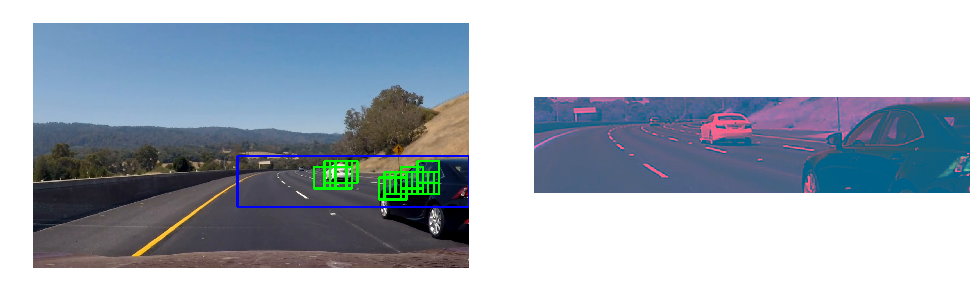

ystop: 615
(225, 680, 3)
(150, 453, 3)
[[(864, 390), (960, 486)], [(1032, 414), (1128, 510)], [(1056, 414), (1152, 510)], [(1080, 414), (1176, 510)], [(1104, 390), (1200, 486)], [(1104, 414), (1200, 510)], [(1128, 390), (1224, 486)], [(1128, 414), (1224, 510)]]


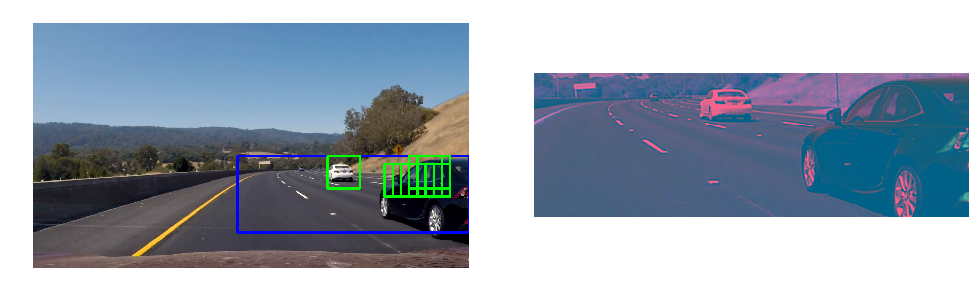

ystop: 666
(276, 680, 3)
(110, 272, 3)
[[(1000, 390), (1160, 550)], [(1040, 390), (1200, 550)], [(1080, 390), (1240, 550)]]


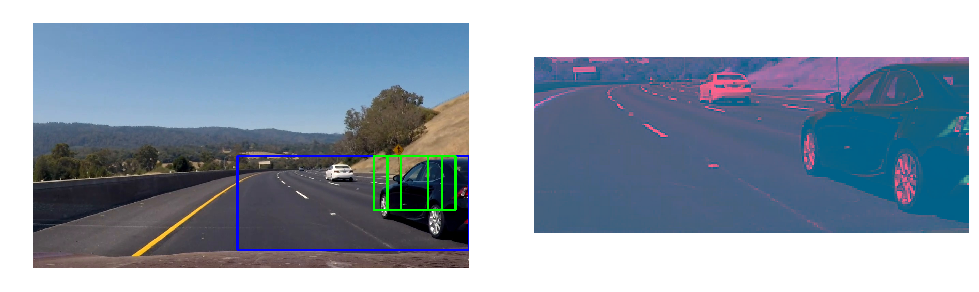

time: 2.54782772064209


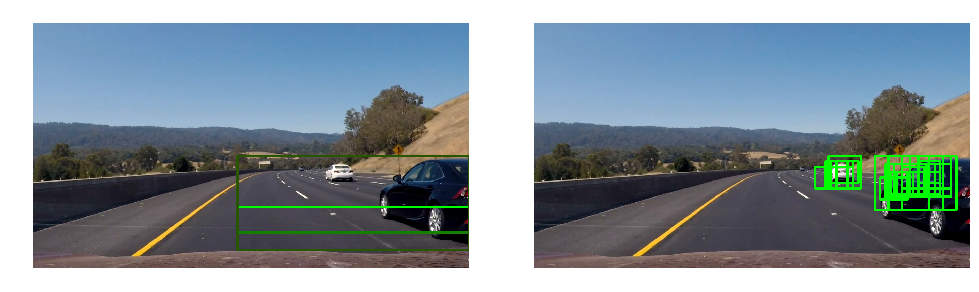

(<matplotlib.figure.Figure at 0x1e0f4ac4278>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1e0f563f748>)

In [22]:
### Please note that this code is adopted from the lesson material.
def find_cars(img, ystart, scale, x_left, svc, pca, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins):
    box_list = []
    # split channel for hog
    ch1 = img[:, :, 0]
    ch2 = img[:, :, 1]
    ch3 = img[:, :, 2]

    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell) - cell_per_block + 1
    nyblocks = (ch1.shape[0] // pix_per_cell) - cell_per_block + 1
    nfeat_per_block = orient * cell_per_block ** 2

    # 64 was the orginal training image size
    window = 64
    nblocks_per_window = (window // pix_per_cell) - cell_per_block + 1
    cells_per_step = 1 # Instead of overlap, define how many cells to step
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step

    # Compute individual channel HOG features for the entire image    
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)

    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb * cells_per_step
            xpos = xb * cells_per_step
            
            xleft = xpos * pix_per_cell
            ytop = ypos * pix_per_cell

            # Extract the image patch
            subimg = cv2.resize(img[ytop:ytop + window, xleft:xleft + window], (64, 64))

            # Get features
            _, spatial_f, hist_f = extract_features(subimg, color_space='RGB', spatial_size=spatial_size,
                                        hist_bins=hist_bins, orient=orient, pix_per_cell=pix_per_cell,
                                        cell_per_block=cell_per_block, hog_feat=False, path = False)
            
            # Get hog features
            hog_feat1 = hog1[ypos:ypos + nblocks_per_window, xpos:xpos + nblocks_per_window].ravel()
            hog_feat2 = hog2[ypos:ypos + nblocks_per_window, xpos:xpos + nblocks_per_window].ravel()
            hog_feat3 = hog3[ypos:ypos + nblocks_per_window, xpos:xpos + nblocks_per_window].ravel()
            
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))
            
            features = np.hstack((hog_features, spatial_f, hist_f ))

            test_features = X_scaler.transform(features.reshape(1, -1))
            
            test_features_pca = pca.transform(test_features)
            test_prediction = svc.predict(test_features_pca)

            if test_prediction == 1:
                xbox_left = np.int(xleft * scale)+x_left
                ytop_draw = np.int(ytop * scale)
                win_draw = np.int(window * scale)
                box_list.append([(xbox_left, ytop_draw + ystart),(xbox_left + win_draw, ytop_draw + win_draw + ystart)])
    
    return box_list

def multi_scale_search(img_in, ystarts, ystops, zooms, svc, pca, X_scaler, color_space, orient,
                      pix_per_cell, cell_per_block, spatial_size, hist_bins, plot_zooms = 0, info= 0):
    
    box_list_all = []
    img = img_in.copy()
    
    for i, zoom in enumerate(zooms):
        # drop upper part of image
        x_left = 600
        img = img_in[ystarts[i]:ystops[i] , x_left:, :]
        ysize = img.shape[0]
        xsize = img.shape[1]
#         print(xsize,ysize)
        
        img = preprocess_img(img, color_space = color_space, edge_enhance = 1)

        # scale single picture hog to new size
        if info:
            print('ystop:', ystops[i])
            print(img.shape)
        if zoom != 1:
            img = cv2.resize(img, (np.int(xsize / zoom), np.int(ysize / zoom)))
        if info:
            print(img.shape)
            
        box_list_temp = find_cars(img, ystarts[i], zoom,x_left , svc, pca, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins)
#         np.array(box_list_temp)[:,:,0] = np.array(box_list_temp)[:,:,0]+ x_left
#         box_list_temp[:,:,0] = box_list_temp[:,:,0] + x_left
    
        box_list_all = box_list_all + box_list_temp
        if info:
            print(box_list_temp)
        if plot_zooms:
#             print(img_in.shape)
#             print(img.shape)
            img_w_zoom = cv2.rectangle(img_in.copy(), (x_left,ystarts[i]), (1280,ystops[i]), (0,0,255), 5)
#             img_w_zoom = cv2.rectangle(img_in.copy(), (xsize,ystarts[i]), (x_left,ystops[i]), (0,0,255), 5)

            plot_two_images(draw_boxes(img_w_zoom, box_list_temp), img, size=(13,5))
        
    return box_list_all   

img = load_image('./video_images/img_716.jpg')
# img = load_image('./test_images/test3.jpg')
svc, X_scaler, pca, color_space, orient, pix_per_cell, spatial_size, hist_bins = joblib.load(SVM_path)

ystarts = [390, 390, 390]#, 390]
ystops = [540, 615, 666]#, 666]
zooms = [1, 1.5, 2.5]# , 3.25]

t1 =  time.time() 

x_left = 600

box_list = multi_scale_search(img, ystarts, ystops, zooms, svc, pca, X_scaler, color_space, orient,
                      pix_per_cell, cell_per_block, spatial_size, hist_bins, plot_zooms = 1, info=1)

print('time:', time.time()- t1)
ysize = img.shape[0]
xsize = img.shape[1]
img2 = img.copy()

for i, ystart in enumerate(ystarts):

    img2 = cv2.rectangle(img2, (xsize,ystart), (x_left,ystops[i]), (20*i,255//(i+1),0), 5)

plot_two_images(img2, draw_boxes(img, box_list), size=(13,5), save_it=1, save_name='multiscale_search')


### 4.2 Heatmap

In [30]:
# Helper function to draw boxes around the detected labels
def draw_labeled_boxes(img, labels, color=(0,255,0), mask = 0):
    mask_img = np.zeros_like(img)
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixel with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixel
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        ymin = np.min(nonzeroy)
        ymax = np.max(nonzeroy)
        xmin = np.min(nonzerox)
        xmax = np.max(nonzerox)

        if mask:
            mask_img[ymin:ymax, xmin:xmax, :] = mask_img[ymin:ymax, xmin:xmax, :] + img[ymin:ymax, xmin:xmax, :]
        else:
            bbox = ((xmin, ymin), (xmax, ymax))
            # Draw the box on the image
            cv2.rectangle(img, bbox[0], bbox[1], color, 6)

            font = cv2.FONT_HERSHEY_SIMPLEX
            text = 'car'
            cv2.putText(img,text, (xmin,ymin-12), font, 1, (0,255,0),2)
            
    if mask:
        return mask_img
    # Return the image
    return img

class Heatmap():
    def __init__(self, history_depth=3, threshold=5):
        
        self.threshold = threshold
        self.history_depth = history_depth
        self.history = np.array([[],[]])
        self.current_heatmap = np.array([[],[]])
        self.smoothed_heatmap = np.array([[],[]])
        self.labels = []
        self.box_points = np.array([])
        
    def add_heat(self, bbox_list):
        self.current_heatmap = np.zeros((720, 1280)).astype(np.uint8)
        for box in bbox_list:
            self.current_heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

        self.__update_history()
         
    def __update_history(self):
        # update history
        if self.history.size == 0:
            self.history = self.current_heatmap.reshape(1,720,1280)
        else:
            self.history = np.vstack((self.history, self.current_heatmap.reshape(1,720,1280)))

        # limit depth of history to 10 newest 
        if self.history.shape[0] > self.history_depth:
            self.history = self.history[1:,:,:]
        
        # calculate sum over history
        self.smoothed_heatmap = np.sum(self.history,axis=0)
        self.smoothed_heatmap = np.array(self.smoothed_heatmap , dtype = 'float')

        # apply threshold to reject false positives
        self.smoothed_heatmap[self.smoothed_heatmap <= self.threshold] = 0
        self.smoothed_heatmap = gaussian_blur(self.smoothed_heatmap, 17)
        self.smoothed_heatmap[self.smoothed_heatmap <= self.threshold*1.05] = 0
        
        self.smoothed_heatmap = norm_0_255(self.smoothed_heatmap)

        

### 4.3 Complete Pipeline

In [31]:
def pipeline_vehicle_detection(frame, debug=False, plot_directly = 0):
    
    box_list = multi_scale_search(frame, ystarts, ystops, zooms, svc, pca, X_scaler, color_space, orient,
                      pix_per_cell, cell_per_block, spatial_size, hist_bins, plot_zooms = 0)

    heatmap.add_heat(box_list)
    
    heatmap.add_heat(box_list)
    
    labels = label(heatmap.smoothed_heatmap)
    
    result = draw_labeled_boxes(np.copy(frame), labels) 
    result_debug = result.copy()
    
    if debug:
        
        font = cv2.FONT_HERSHEY_DUPLEX
        text_color = (200,255,155)
        
        text = 'Result:  ' + '{}'.format(labels[1]) + ' cars detected'
        cv2.putText(result, text, (40,40), font, 1.5, text_color, 2, cv2.LINE_AA)
        
        box_img = draw_boxes(frame, box_list)
        text = 'Number of feature boxes: ' + '{}'.format(len(box_list))
        cv2.putText(box_img, text, (40,40), font, 1.5, text_color, 2, cv2.LINE_AA)

        result_debug = np.hstack((result, box_img)) # put input image and resulting image on top of each other
    
        #################################################
        cmap = plt.get_cmap('hot')
#         heatmap_out = heatmap.history/heatmap.history.max()
#         heatmap_rgb = norm_0_255(cmap(heatmap_out)[:,:,0:3])
        heatmap_rgb = np.zeros_like(box_img)
        heatmap_rgb[:,:,0] = norm_0_255(np.sum(heatmap.history,axis=0) ) 
        heatmap_rgb[:,:,1] = norm_0_255(heatmap.smoothed_heatmap )
        
        text = 'Heatmap, max:' + '{}'.format(heatmap.history.max())
        cv2.putText(heatmap_rgb, text, (40,40), font, 1.5, text_color, 2, cv2.LINE_AA)
        show_car_img = draw_labeled_boxes(np.copy(frame), labels, mask = 1)
#         show_car_img = cv2.bitwise_and(frame,frame, mask = heatmap.smoothed_heatmap)
        
        debug_out = np.hstack((heatmap_rgb, show_car_img)) # put threshold and debug output on top of each other
        
        result_debug = np.vstack((result_debug, debug_out)) # combine all four images into one
    if plot_directly:      
        plot_two_images(result,result_debug, size=(13, 5), save_it=1, save_name= 'pipeline_vehicle_detection')
    return result


#### Example complete pipeline

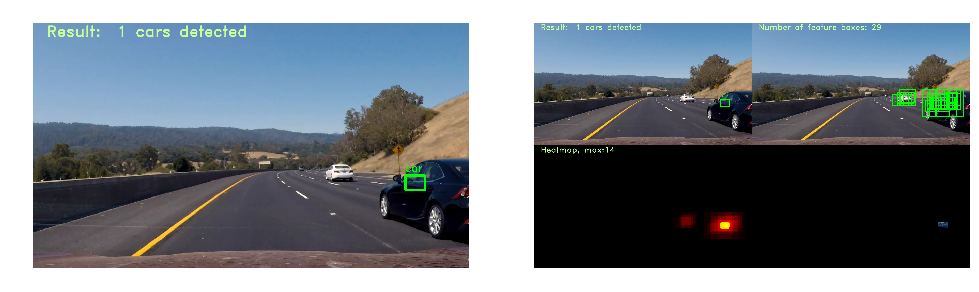

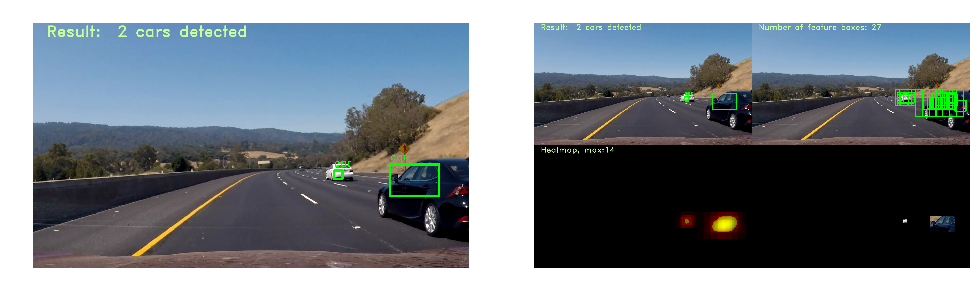

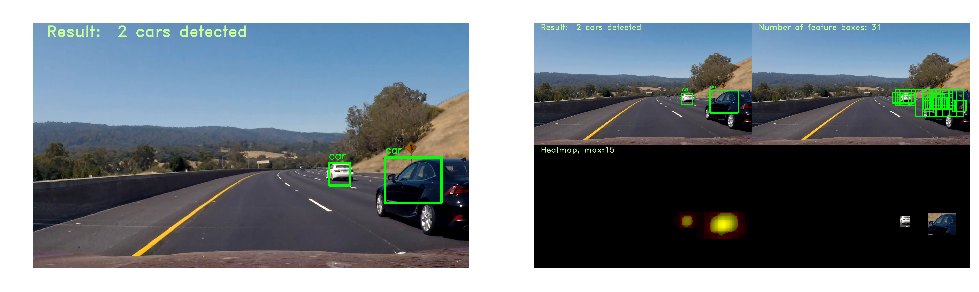

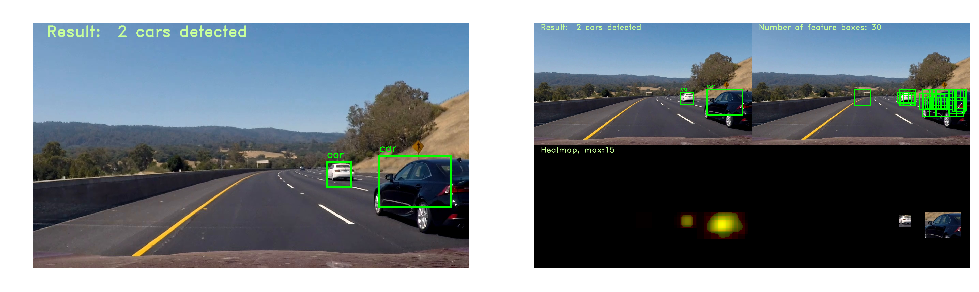

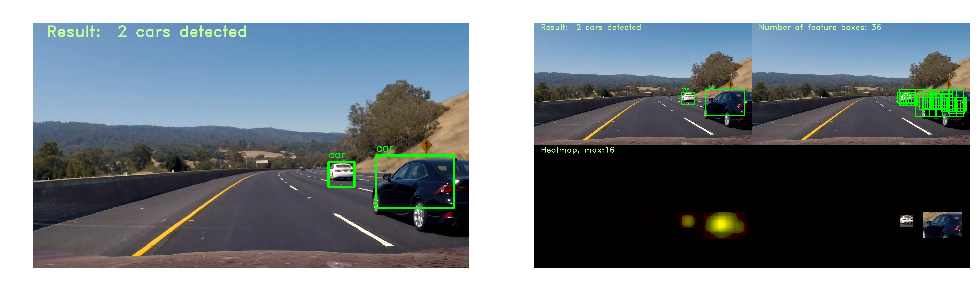

...

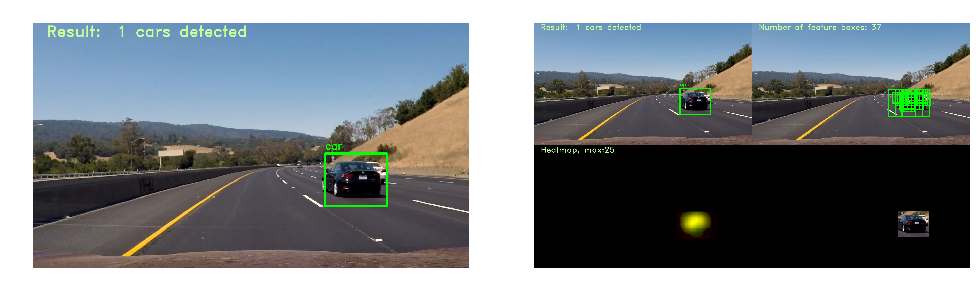

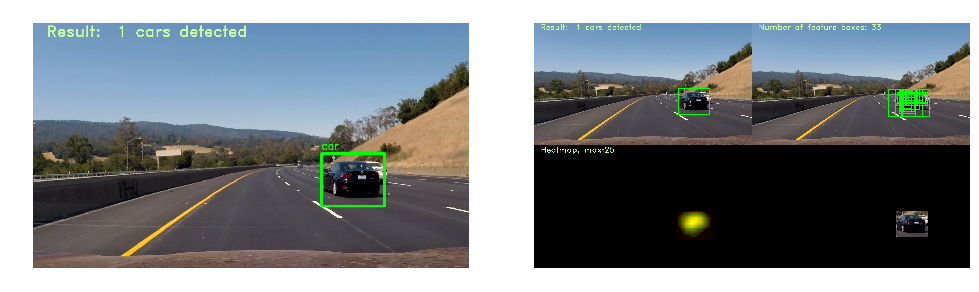

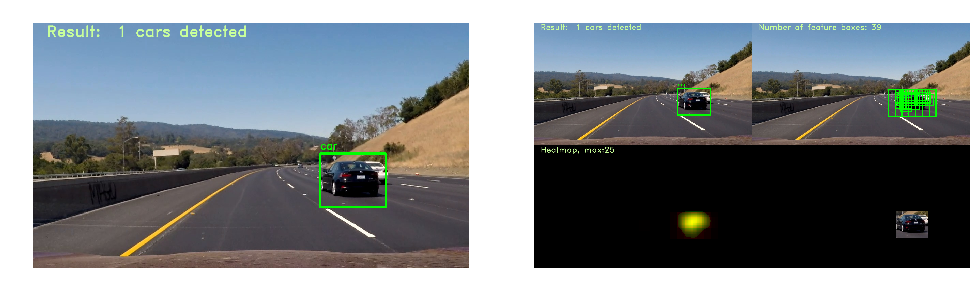

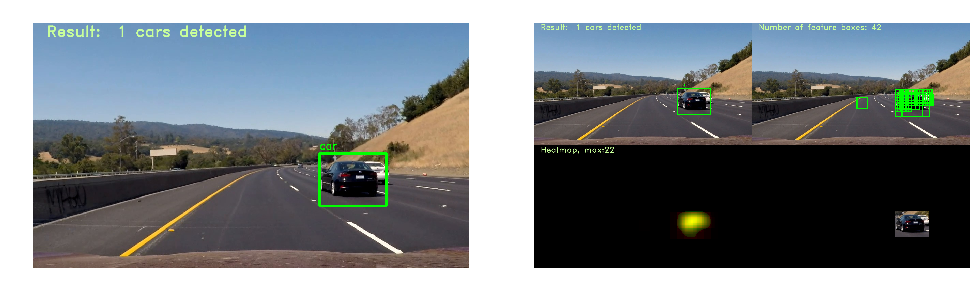

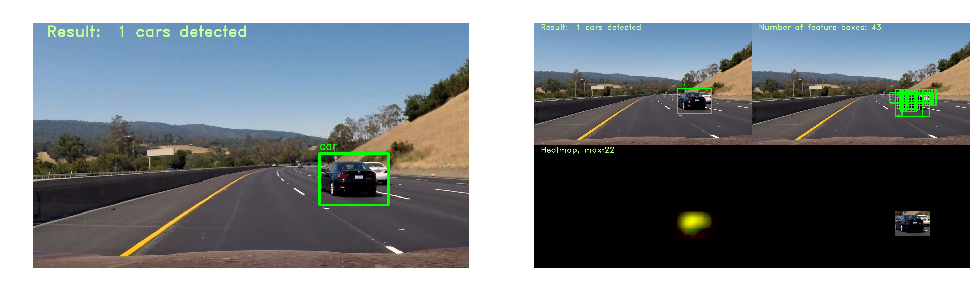

In [33]:
# images = glob.glob('./test_images/test*')
images = glob.glob('./video_images2/*jpg')
heatmap = Heatmap(history_depth = 8, threshold = 20)

for n, filename in enumerate(images):

    img = load_image(filename)
    
    img = pipeline_vehicle_detection(img, debug=True, plot_directly = 1)


# 5 Video processing

In [34]:
def process_frame(frame):
    return pipeline_vehicle_detection(frame, debug=True, plot_directly = 0)

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

svc, X_scaler, pca, color_space,orient, pix_per_cell, spatial_size, hist_bins = joblib.load('SVM_best.pkl')

heatmap = Heatmap(history_depth = 10, threshold = 25)

project_output = 'project_video_output.mp4'

clip = VideoFileClip("project_video.mp4")#.subclip(23,30)
project_clip = clip.fl_image(process_frame) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_video_output2.mp4
[MoviePy] Writing video project_video_output2.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [29:37<00:01,  1.40s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output2.mp4 

Wall time: 29min 38s
